# Land use classification using satellite imagery input

 The working idea proposed below is to apply an unsupervised classification algorithm to obtain different groups of elements that are closely related in the map. Then we reclassify these groups into the land uses of interest using google earth and maps as a validation of the decisions taken.  

 From the obtained labels, I train a predictive algorithm to generate a tool that allows to differentiate land uses in the province of Cordoba in an automatic way. 
 
 Finally, I extrapolate the results obtained to a site that has not been trained and discuss the performance of the predictive algorithm.

In [ ]:
# Imports

## Load data
import os
import numpy as np
import matplotlib.pyplot as plt  
import rasterio as rio
from rasterio.plot import show
from matplotlib.pyplot import figure

## Unsupervised learning
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import colors
from skimage.color import rgb2gray, rgb2hsv, hsv2rgb
from skimage.io import imread, imshow
from sklearn.cluster import KMeans
from sklearn.cluster import MiniBatchKMeans

## Result image visualization
import mpl_toolkits.axes_grid1 as axes_grid1

## Supervised learning
import pandas as pd

### Metrics
from sklearn.metrics import accuracy_score
from sklearn.metrics import balanced_accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import roc_auc_score

### Linear regression
from sklearn.linear_model import LinearRegression

### XGBoost and Bayes hiperparameter optimization
import numpy as np
from xgboost import XGBClassifier
# from bayes_opt import BayesianOptimization
from sklearn.model_selection import cross_val_score
import warnings; warnings.simplefilter('ignore')

1. I lift the bands from the LandsaTM 229-82 image and load them into a numpy array.

In [80]:
def rasterio_open(f: str) -> rio.io.DatasetReader:
    '''
      rasterio_open: open file path f using rasterio (as rio)
    '''
    return rio.open(f)

def realce_p(imag, p):
  '''
  input:
    imag : image to be linearly enhanced
    p : percentage to rescale
  '''
  aux = np.sort(imag.flatten()) #ordena de mayor a menor
  imin = int(len(aux) * p / 100)
  imax = int(len(aux) * (100 - p) / 100)
  vmin = float(aux[imin]) # para no tener problemas con uint8
  vmax = aux[imax]
  rimag = (imag - vmin) / (vmax - vmin)
  rimag[rimag < 0] = 0  
  rimag[rimag > 1] = 1
  return rimag

In [66]:
# BAND1
BAND1 = rasterio_open("BAND1.tif")
BAND1_array = BAND1.read(1)
BAND1_array = BAND1_array.astype('f4')
BAND1_array= realce_p(BAND1_array,2)
BAND1.close()

# BAND2
BAND2 = rasterio_open("BAND2.tif")
BAND2_array = BAND2.read(1)
BAND2_array = BAND2_array.astype('f4')
BAND2_array= realce_p(BAND2_array,2)
BAND2.close()

# BAND3
BAND3 = rasterio_open("BAND3.tif")
BAND3_array = BAND3.read(1)
BAND3_array = BAND3_array.astype('f4')
BAND3_array= realce_p(BAND3_array,2)
BAND3.close()

# BAND4
BAND4 = rasterio_open("BAND4.tif")
BAND4_array = BAND4.read(1)
BAND4_array = BAND4_array.astype('f4')
BAND4_array= realce_p(BAND4_array,2)
BAND4.close()

# BAND5
BAND5 = rasterio_open("BAND2.tif")
BAND5_array = BAND5.read(1)
BAND5_array = BAND5_array.astype('f4')
BAND5_array= realce_p(BAND5_array,2)
BAND5.close()

# BAND6
BAND6 = rasterio_open("BAND6.tif")
BAND6_array = BAND6.read(1)
BAND6_array = BAND6_array.astype('f4')
BAND6_array= realce_p(BAND6_array,2)
BAND6.close()

# BAND7
BAND7 = rasterio_open("BAND7.tif")
BAND7_array = BAND7.read(1)
BAND7_array = BAND7_array.astype('f4')
BAND7_array= realce_p(BAND7_array,2)
BAND7.close()

# BAND8
BAND8 = rasterio_open("BAND8.tif")
BAND8_array = BAND8.read(1)
BAND8_array = BAND8_array.astype('f4')
BAND8_array= realce_p(BAND8_array,2)
BAND8.close()

In [67]:
rgb = np.dstack((BAND5_array,BAND3_array,BAND1_array))

# Full image

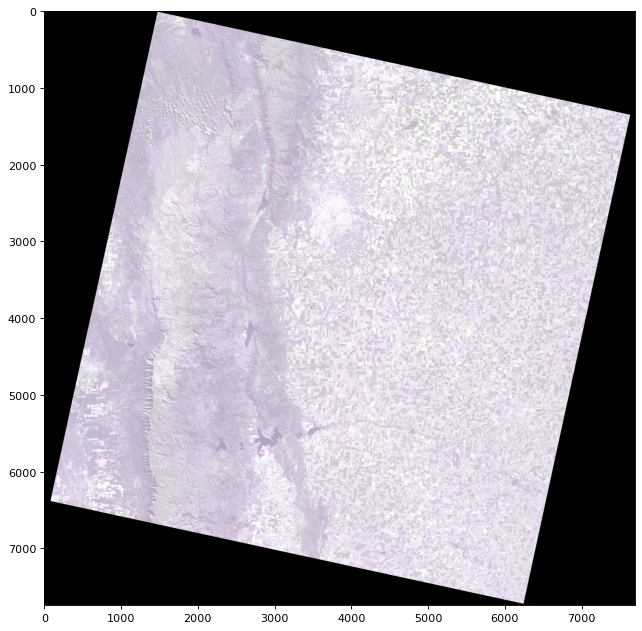

In [72]:
figure(figsize=(12, 8), dpi=80)
plt.imshow(rgb,vmin=0,vmax=1)

In [5]:
nfil = 7761
ncol = 7691
banda="12345678" # Nombre de las bandas disponibles
nbands = len(banda)
img0 = np.zeros([nfil, ncol, nbands] ,dtype=np.float64) 

In [6]:
img0[: ,: , 0] = BAND1_array
img0[: ,: , 1] = BAND2_array
img0[: ,: , 2] = BAND3_array
img0[: ,: , 3] = BAND4_array
img0[: ,: , 4] = BAND5_array
img0[: ,: , 5] = BAND6_array
img0[: ,: , 6] = BAND7_array
img0[: ,: , 7] = BAND8_array

In [7]:
del BAND1_array
del BAND2_array
del BAND3_array
del BAND4_array
del BAND5_array
del BAND6_array
del BAND7_array
del BAND8_array

We make a cut to be able to work.
I am trying to cut so that the localities of Cordoba city, Carlos Paz, Alta Gracia, Villa Allende, Monte Cristo, Rio Segundo and Pilar are retained in the cut with which we are going to work. 

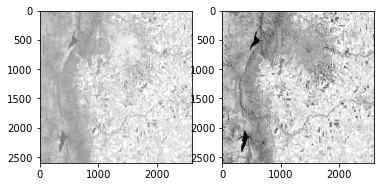

In [8]:
lfil = 2600
lcol = 2600

plt.subplot(1,2,1)
plt.imshow(img0[2000:4600,2200:4800,3], 'gray')
plt.subplot(1,2,2)
plt.imshow(img0[2000:4600,2200:4800,5], 'gray')

# Cordoba between rows 2500 and 3200
# Carlos paz 

# plt.imshow(img0[:lfil,:lcol,0])

fil0 = 2000 #coordinate of the first row 
col0 = 2200 #coordinate of the first column

rec = img0[fil0: fil0 + lfil, col0: col0 + lcol, :]

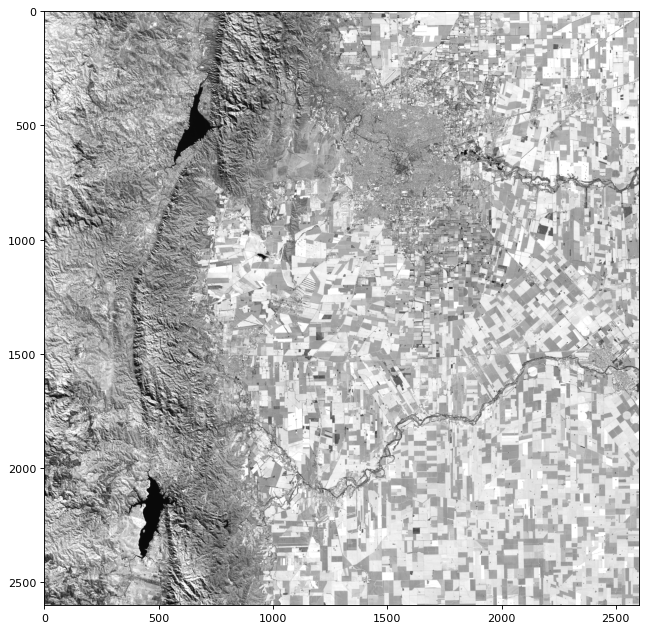

In [70]:
figure(figsize=(12, 8), dpi=80)
plt.imshow(rec[:,:,5], 'gray')

In [73]:
# plt.imshow(rec[:,:,5], 'gray')

In [130]:
rec.shape

(2600, 2600, 8)

We use the upper part of the image to train the algorithm and the lower part to test it.

After performing the enhancement of the cropping of the image with which we are going to work. We proceed to dump the data of the bands in a data frame to subsequently perform the unsupervised classification.

In [9]:
def image_to_pandas(image):
    df = pd.DataFrame([image[:,:,0].flatten(),
                       image[:,:,1].flatten(),
                       image[:,:,2].flatten(),
                       image[:,:,3].flatten(),
                       image[:,:,4].flatten(),
                       image[:,:,5].flatten(),
                       image[:,:,6].flatten(),
                       image[:,:,7].flatten()]).T
    df.columns = ["band1","band2","band3","band4","band5","band6","band7","band10"]
    return df

df = image_to_pandas(rec)
df.head(5)

,band1,band2,band3,band4,band5,band6,band7,band10
0,0.901357,0.878040,0.839719,0.791429,0.878040,0.859247,0.879667,0.941205
1,0.903670,0.884630,0.855610,0.810672,0.884630,0.880645,0.873198,0.943672
2,0.920764,0.900965,0.870614,0.836963,0.900965,0.916910,0.897374,0.945381
3,0.935445,0.905142,0.863273,0.823077,0.905142,0.940901,0.955759,0.948375
4,0.927803,0.908947,0.874728,0.836047,0.908947,0.937428,0.953182,0.951011


## Unsupervised classification:
## K-Means clustering method.
I proceed to make the clusters, as we seek to classify in 4 land uses as in the guide, then I define k=4 (Urban, Forest, Agricultural, Water) (Urbano, Monte, Agricola, Agua).

### K=4

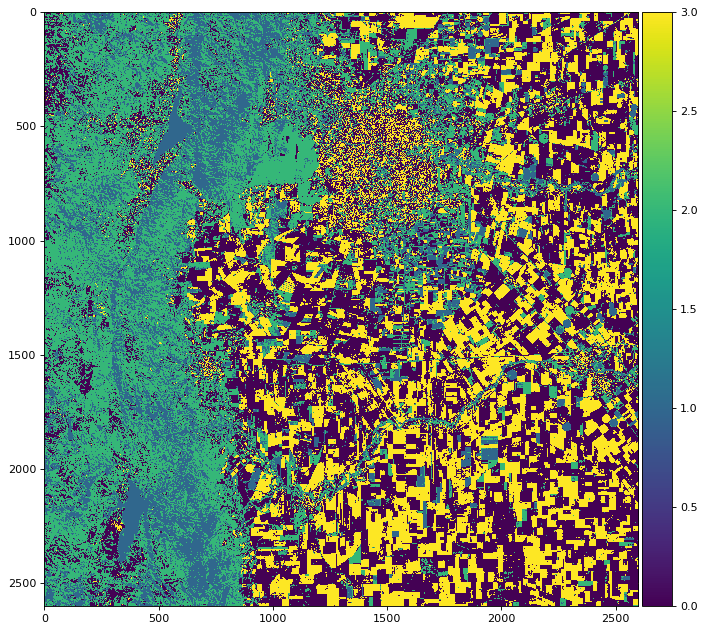

In [75]:
plt.figure(num=None, figsize=(12, 8), dpi=80)
kmeans = KMeans(n_clusters=  4, random_state = 8).fit(df)
result4 = kmeans.labels_.reshape(rec.shape[0],rec.shape[1])
imshow(result4, cmap='viridis')
plt.show()

We can notice that with a small K, the algorithm does not manage to differentiate the land uses in which we want to classify. It can be seen that it is better able to differentiate crops from each other than water from bush. For this reason I will proceed to use the method with a larger K in order to take the segmentation to its maximum expression and then group according to what we know about the sites and what can be explored through google maps and earth. 

We see that with a K equal to 12, the differentiation of the clusters is much more homogeneous, therefore the decision to increase the parameter was correct. 

Below we can observe each of the clusters created by the method:

From the results previously obtained we should re-classify the clusters obtained in the groups of interest and obtain the labels. However, we chose to use an algorithm that works better for satellite images and allows us to increase the K even more optimizing the execution time.

# Method used K-Means with mini batch clustering.
I try another clustering method

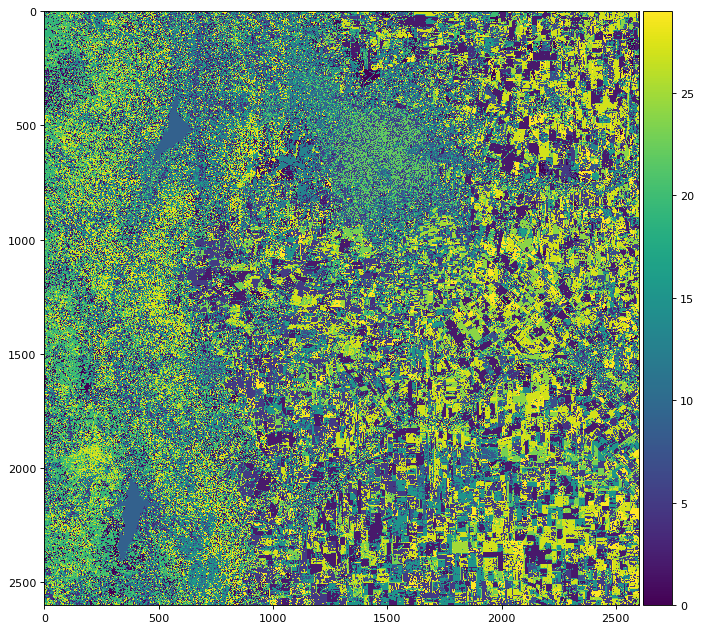

In [77]:
plt.figure(num=None, figsize=(12, 8), dpi=80)
MB_KMeans = MiniBatchKMeans(n_clusters=  30, random_state = 8).fit(df)
result30 = MB_KMeans.labels_.reshape(rec.shape[0],rec.shape[1])
imshow(result30, cmap='viridis')
plt.show()

We plotted each of the 20 clusters created and proceeded to regroup them into the land uses of interest.

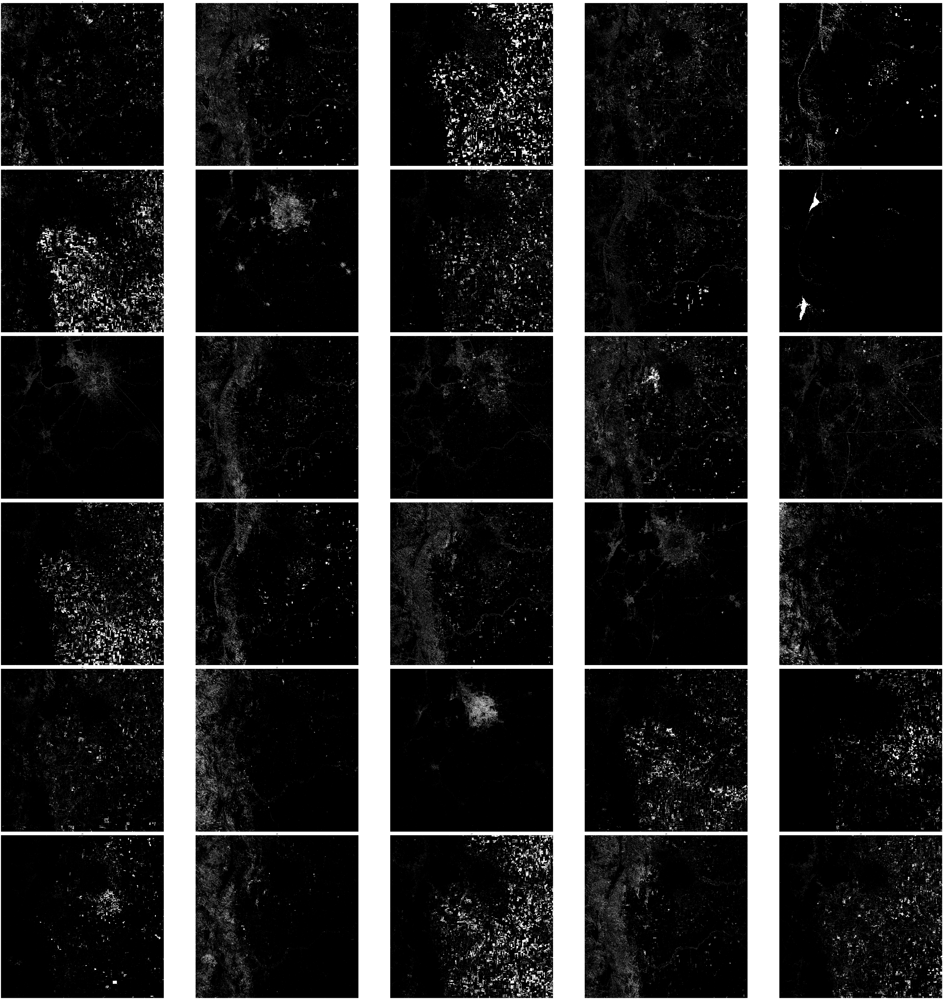

In [133]:
fig, axes = plt.subplots(6,5, figsize=(100, 100))
for n, ax in enumerate(axes.flatten()):
    ax.imshow(result30==[n], cmap='gray');
    ax.set_title(n)
    ax.set_axis_off()
    
fig.tight_layout()

### Re-grouping of the clusters created in the land uses of interest

In [13]:
# results=np.zeros_like(result30)

In [187]:
# for i in range(0,result30.shape[0]):
#     for j in range(0,result30.shape[1]):
#         # Urbano
#         if ((result30[i,j] == 6)|(result30[i,j] == 22)): 
#             results[i,j]=int(0) # Urbano Alta Compacidad
#         if ((result30[i,j] == 10)|(result30[i,j] == 18)): 
#             results[i,j]=int(1) # Urbano Media Compacidad
#         if ((result30[i,j] == 12)): 
#             results[i,j]=int(2) # Urbano Baja Compacidad
        
#          # Agua
#         if ((result30[i,j] == 9)): 
#             results[i,j]=int(3) # Agua
        
#         # Natural
#         if ((result30[i,j] == 4)|(result30[i,j] == 11)|(result30[i,j] == 16)|(result30[i,j] == 17)|(result30[i,j] ==19 )|(result30[i,j] == 21)|(result30[i,j] == 26)|(result30[i,j] == 28)): 
#             results[i,j]=int(4) # Monte 
#         if ((result30[i,j] == 1)|(result30[i,j] == 13)): 
#             results[i,j]=int(5) # Matorral/arbustal
#         if ((result30[i,j] == 0)|(result30[i,j] == 3)|(result30[i,j] == 8)|(result30[i,j] ==14 )): 
#             results[i,j]=int(6) # Pastizal
            
#         # Cultivo   
#         if ((result30[i,j] == 2)|(result30[i,j] == 5)|(result30[i,j] == 15)|(result30[i,j] == 27)): 
#             results[i,j]=int(7) # Cultivo Extensivo Anual
        
#         if ((result30[i,j] == 7)|(result30[i,j] == 20)|(result30[i,j] == 23)|(result30[i,j] == 24)|(result30[i,j] == 25)|(result30[i,j] == 29)): 
#             results[i,j]=int(8) # Cultivo Horticola Multiespecifico

In [81]:
# np.savetxt('labels_mbk_30.txt', results, fmt='%d')
labels = np.loadtxt('labels_mbk_30.txt', dtype=int)

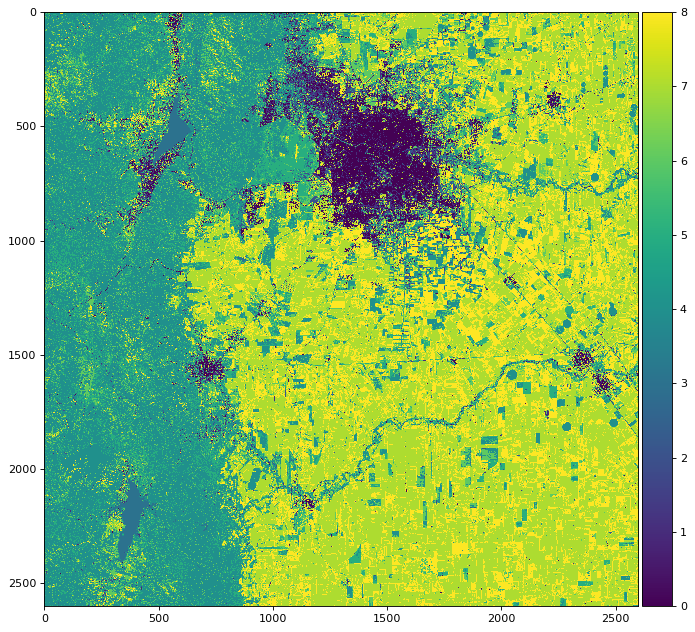

In [82]:
plt.figure(figsize=(12, 8), dpi=80)
imshow(labels, cmap='viridis')
plt.show()

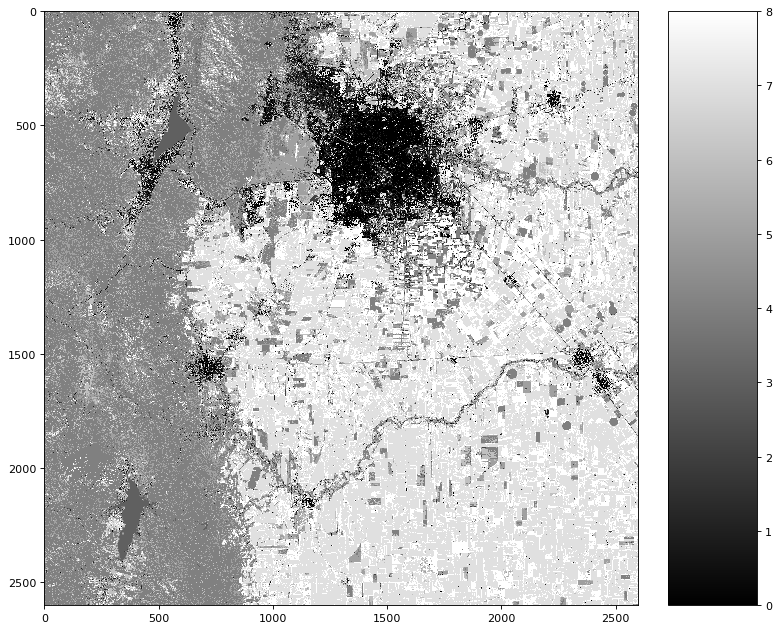

In [83]:
np.random.seed(1)

fig = plt.figure(figsize=(12,8), dpi=80)
grid = axes_grid1.AxesGrid(
    fig, 111, nrows_ncols=(1, 1), axes_pad = 0.5, cbar_location = "right",
    cbar_mode="each", cbar_size="15%", cbar_pad="5%",)

im0 = grid[0].imshow(labels, cmap='gray', interpolation='nearest')
grid.cbar_axes[0].colorbar(im0)

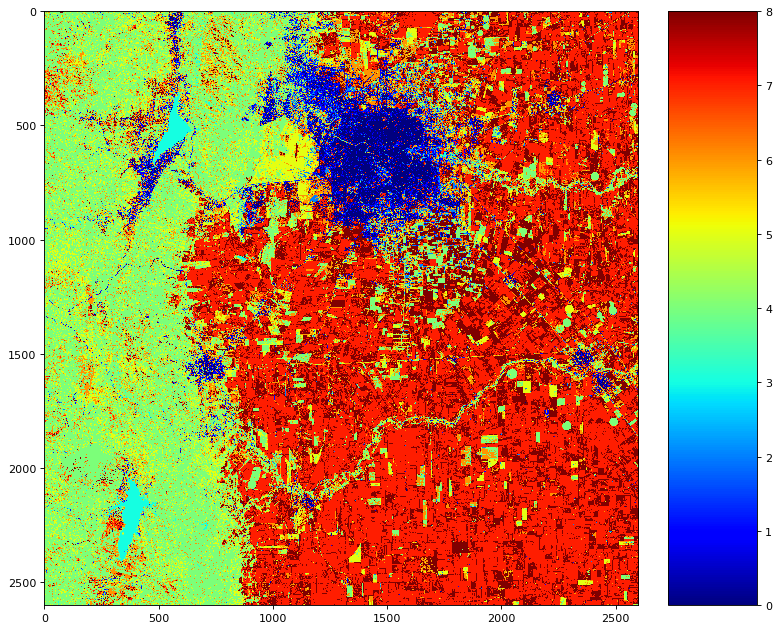

In [84]:
fig = plt.figure(figsize=(12,8), dpi=80)
grid = axes_grid1.AxesGrid(
    fig, 111, nrows_ncols=(1, 1), axes_pad = 0.5, cbar_location = "right",
    cbar_mode="each", cbar_size="15%", cbar_pad="5%",)

im1 = grid[0].imshow(labels, cmap='jet', interpolation='nearest')
grid.cbar_axes[0].colorbar(im1)

https://gn-idecor.mapascordoba.gob.ar/maps/302/view

## Predictive model fitting
First we proceed to divide the database into training and testing. I will proceed to train the algorithm with the portion of the database that covers Cordoba Capital and Carlos Paz and I will use as test dataset the remaining portion of the clipping we have been working with.

### Train

In [85]:
x_train= df.loc[:5199999,:]
y_train= labels.flatten()[:5200000]
x_test= df.loc[5200000:,:]
y_test=labels.flatten()[5200000:]

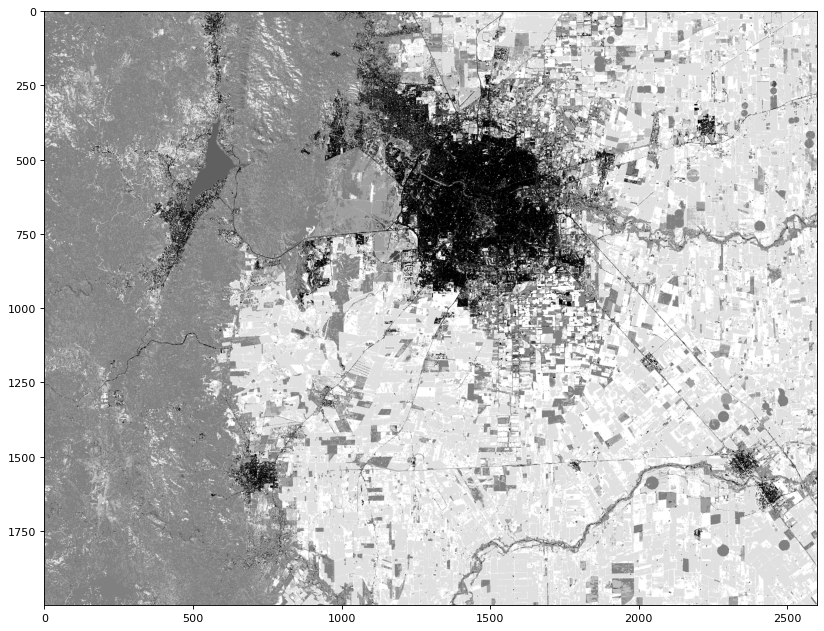

In [86]:
train_plot = y_train.reshape(2000,2600)
plt.figure(figsize=(12,8), dpi=80)
plt.imshow(train_plot, 'gray')

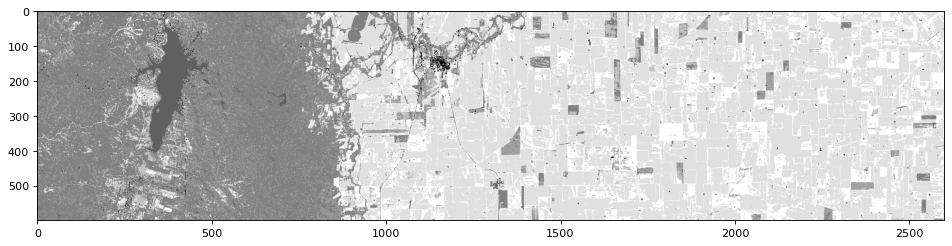

In [87]:
test_plot = y_test.reshape(600,2600)
plt.figure(figsize=(12,8), dpi=80)
plt.imshow(test_plot, 'gray')

In [195]:
x_train.shape

(5200000, 8)

In [196]:
y_train.shape

(5200000,)

In [197]:
x_test.shape

(1560000, 8)

In [198]:
y_test.shape

(1560000,)

([0, 1, 2, 3, 4, 5, 6, 7, 8],
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

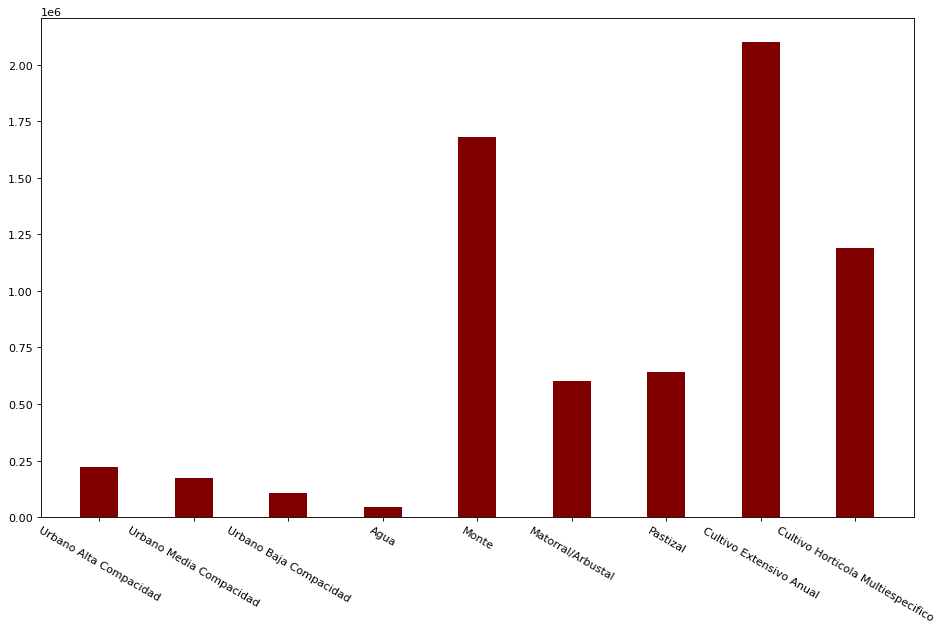

In [121]:
unique, counts = np.unique(labels, return_counts=True)
result = np.column_stack((unique, counts)) 

columns = ['Categoria', 'Valor']
df_res=pd.DataFrame(result)
df_res.head()
df_res[0] = df_res[0].astype(str)
df_res[0] = df_res[0].replace({'0':'Urbano Alta Compacidad', '1':'Urbano Media Compacidad','2':'Urbano Baja Compacidad', '3':'Agua',
                              '4':'Monte', '5':'Matorral/Arbustal','6':'Pastizal', '7':'Cultivo Extensivo Anual', '8':'Cultivo Horticola Multiespecifico'})

plt.figure(figsize=(12,8), dpi=80)
plt.bar(df_res[0], df_res[1], color ='maroon',
        width = 0.4)
plt.xticks(rotation=330)

([0, 1, 2, 3, 4, 5, 6, 7, 8],
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

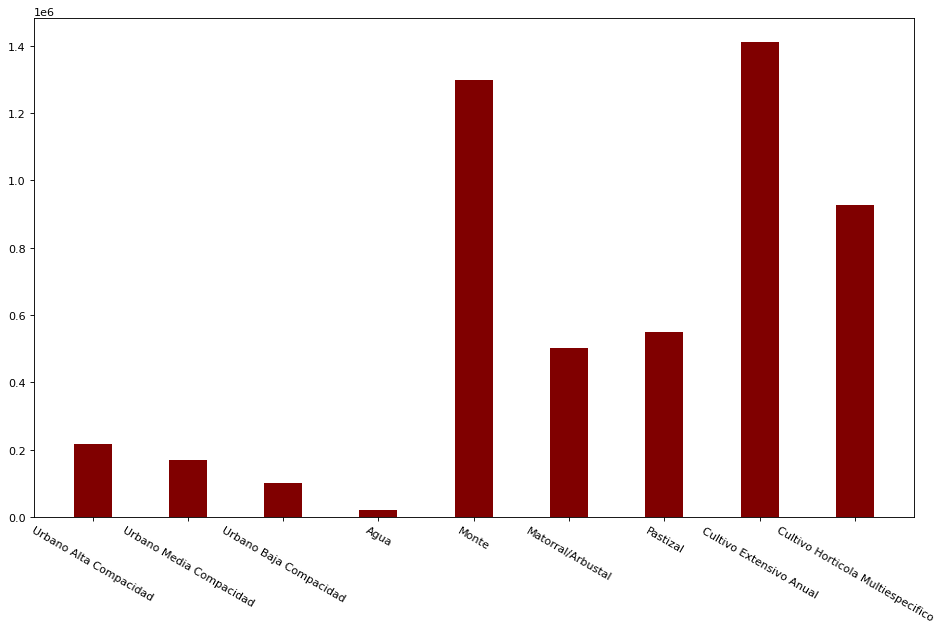

In [122]:
unique, counts = np.unique(y_train, return_counts=True)
result = np.column_stack((unique, counts)) 

columns = ['Categoria', 'Valor']
df_res=pd.DataFrame(result)
df_res.head()
df_res[0] = df_res[0].astype(str)
df_res[0] = df_res[0].replace({'0':'Urbano Alta Compacidad', '1':'Urbano Media Compacidad','2':'Urbano Baja Compacidad', '3':'Agua',
                              '4':'Monte', '5':'Matorral/Arbustal','6':'Pastizal', '7':'Cultivo Extensivo Anual', '8':'Cultivo Horticola Multiespecifico'})

plt.figure(figsize=(12,8), dpi=80)
plt.bar(df_res[0], df_res[1], color ='maroon',
        width = 0.4)
plt.xticks(rotation=330)

([0, 1, 2, 3, 4, 5, 6, 7, 8],
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

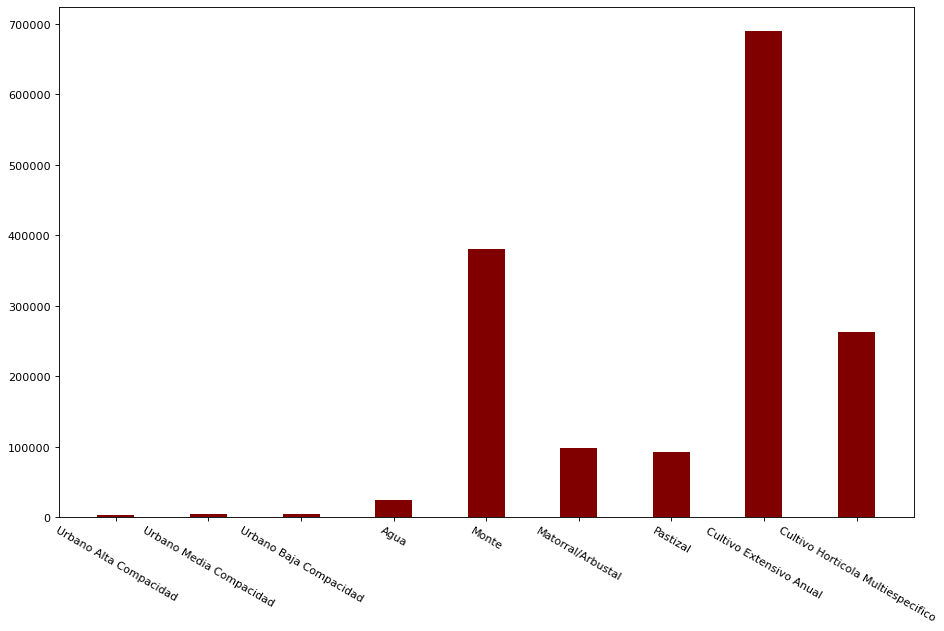

In [123]:
unique, counts = np.unique(y_test, return_counts=True)
result = np.column_stack((unique, counts)) 

columns = ['Categoria', 'Valor']
df_res=pd.DataFrame(result)
df_res.head()
df_res[0] = df_res[0].astype(str)
df_res[0] = df_res[0].replace({'0':'Urbano Alta Compacidad', '1':'Urbano Media Compacidad','2':'Urbano Baja Compacidad', '3':'Agua',
                              '4':'Monte', '5':'Matorral/Arbustal','6':'Pastizal', '7':'Cultivo Extensivo Anual', '8':'Cultivo Horticola Multiespecifico'})

plt.figure(figsize=(12,8), dpi=80)
plt.bar(df_res[0], df_res[1], color ='maroon',
        width = 0.4)
plt.xticks(rotation=330)

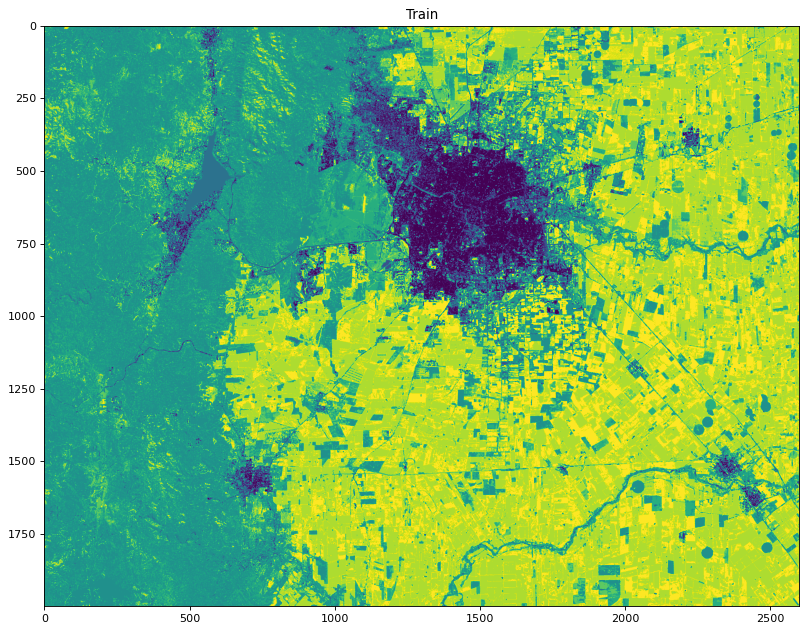

In [124]:
plt.figure(figsize=(12,8), dpi=80)
plt.title("Train")
plt.imshow(labels[0:2000,0:2600])

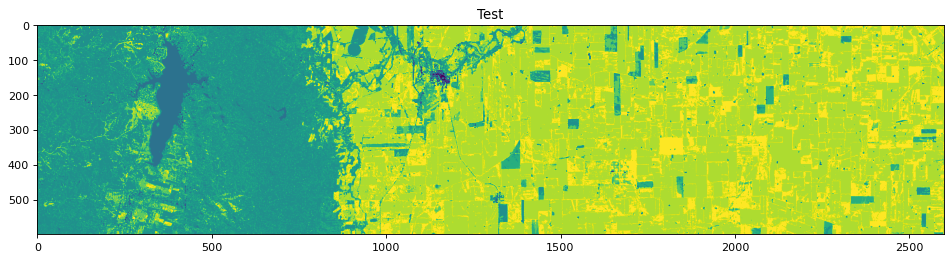

In [125]:
plt.figure(figsize=(12,8), dpi=80)
plt.title("Test")
plt.imshow(labels[2000:,0:2600])

### Hyperparameter search by Bayesian Search:
 I run a hyperparameter search Bayesian search, the results obtained are:

* 'colsample': 1.0,
* 'gamma': 0.2668127255854019,
* 'learning_rate': 0.578376429437093,
* 'max_depth': 5.494385773398772,
* 'n_estimators': 630.3749832129558,
* 'subsample': 1.0

In [204]:
model = XGBClassifier(colsample_bytree=0.6,
     gamma=5,
     max_depth=5,
     min_child_weight=10,
     subsample=1.0)

In [205]:
# # fit model
# model.fit(x_train, y_train)

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=0.6,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, gamma=5, gpu_id=-1, grow_policy='depthwise',
              importance_type=None, interaction_constraints='',
              learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=5, max_leaves=0, min_child_weight=10,
              missing=nan, monotone_constraints='()', n_estimators=100,
              n_jobs=0, num_parallel_tree=1, objective='multi:softprob',
              predictor='auto', random_state=0, reg_alpha=0, ...)

In [206]:
# # save to JSON
# model.save_model("model.json")
# # save to text format
# model.save_model("model.txt")

In [19]:
model = XGBClassifier()
model.load_model("model.json")

In [22]:
# make predictions for test data
y_pred = model.predict(x_test)

In [209]:
y_pred.shape

(1560000,)

I calculate some ranking metrics to evaluate the performance of the adjusted model:

In [24]:
# Metrics in test set
preds= y_pred
acc=accuracy_score(y_test,preds)
print("Accuracy",acc)
bac=balanced_accuracy_score(y_test,preds)
print("Balanced Accuracy Score =",bac)
f1=f1_score(y_test,preds,average='macro')
print("F1 score =",f1)
prec=precision_score(y_test,preds,average='macro')
print("Precision =",prec)
rec=recall_score(y_test,preds,average='macro')
print("Recall =",rec)
# roc=roc_auc_score(y_test,preds,average='macro')
# print("Roc Auc =",roc)

# res = ["XGBoost with out SC", score, mse, rmse, evs, mae]
# results.loc[len(results.index)+1] = res

Accuracy 0.9768128205128205
Balanced Accuracy Score = 0.9661348362833473
F1 score = 0.9660900919136465
Precision = 0.9661102239734716
Recall = 0.9661348362833473


Its performance appears to be very good.

In [25]:
preds_plot = preds.reshape(600,2600)

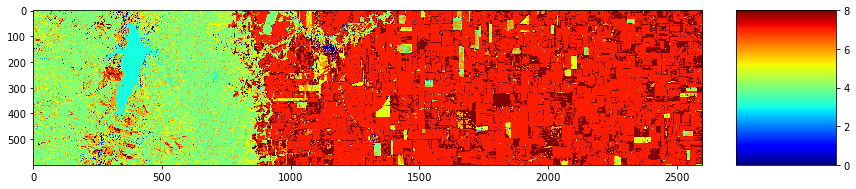

In [126]:
# plt.title("Originales Test")
fig = plt.figure(figsize=(12, 8))
grid = axes_grid1.AxesGrid(
    fig, 111, nrows_ncols=(1, 1), axes_pad = 0.5, cbar_location = "right",
    cbar_mode="each", cbar_size="15%", cbar_pad="5%",)

im1 = grid[0].imshow(labels[2000:,0:2600], cmap='jet', interpolation='nearest')
grid.cbar_axes[0].colorbar(im1)


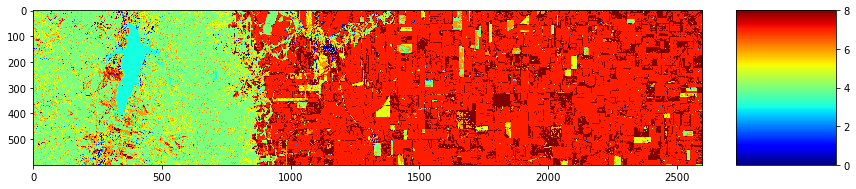

In [127]:
# Predichos
fig = plt.figure(figsize=(12, 8))
grid = axes_grid1.AxesGrid(
    fig, 111, nrows_ncols=(1, 1), axes_pad = 0.5, cbar_location = "right",
    cbar_mode="each", cbar_size="15%", cbar_pad="5%",)

im1 = grid[0].imshow(preds_plot, cmap='jet', interpolation='nearest')
grid.cbar_axes[0].colorbar(im1)

In [181]:
# # save to JSON
# model.save_model("model.json")
# # save to text format
# model.save_model("model.txt")

 ### I apply the model to another zone
 
I will now proceed to apply the model to predict data that are not classified and which have not participated in the model training process, I will emphasize the Embalse and Rio tercero area.

 I will also attach the band combinations that highlight the different land uses developed in guide 3 to get an idea of what is expected to be classified. 

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


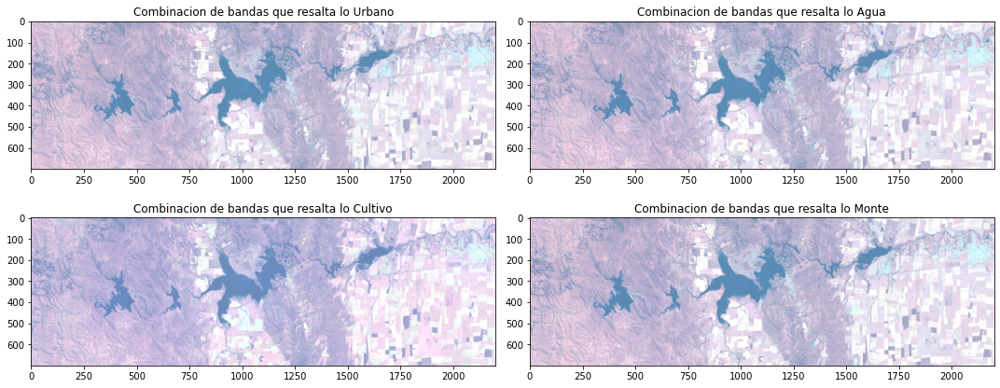

In [52]:
predecir = img0[5300:6000,1800:4000, :]

plt.figure(figsize=(15, 6))
plt.subplot(2,2,1)
plt.title('Combinacion de bandas que resalta lo Urbano')
plt.imshow(predecir[:,:,[5,3,1]], "gray")
# plt.imshow(predecir_realzada[:,:,[0,2,3]], "gray")


plt.subplot(2,2,2)
plt.title('Combinacion de bandas que resalta lo Agua')
plt.imshow(predecir[:,:,[5,3,1]], "gray")

plt.subplot(2,2,3)
plt.title('Combinacion de bandas que resalta lo Cultivo')
plt.imshow(predecir[:,:,[6,3,0]], "gray")

plt.subplot(2,2,4)
plt.title('Combinacion de bandas que resalta lo Monte')
plt.imshow(predecir[:,:,[5,3,4]], "gray")

plt.tight_layout()
plt.legend()
plt.show()

Predictions: 

In [53]:
nuevo = image_to_pandas(predecir)
nuevo.head(5)

,band1,band2,band3,band4,band5,band6,band7,band10
0,0.895023,0.871171,0.838429,0.802284,0.871171,0.908295,0.900060,0.971741
1,0.924686,0.891498,0.861983,0.838232,0.891498,0.942013,0.942547,0.972184
2,0.919658,0.897995,0.867145,0.841052,0.897995,0.949840,0.944356,0.971994
3,0.915837,0.886764,0.855288,0.820892,0.886764,0.951600,0.938052,0.972711
4,0.896430,0.873120,0.846656,0.804469,0.873120,0.948775,0.917165,0.972986


In [54]:
#  make predictions for test data
pred2 = model.predict(nuevo)

In [55]:
# Vuelvo a tamaño original:
pred_plot2 = pred2.reshape(700,2200)

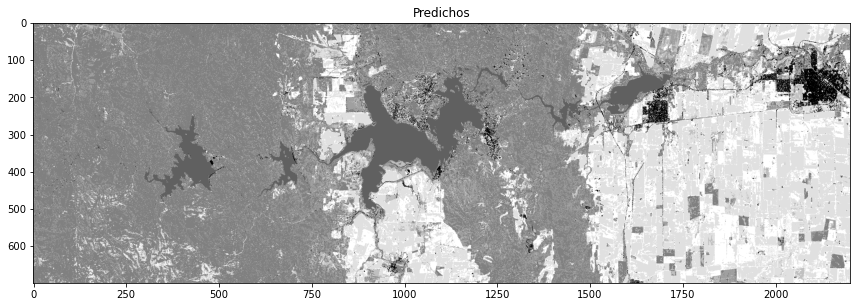

In [128]:
plt.figure(figsize=(12, 8))
plt.title("Predichos")
plt.imshow(pred_plot2, "gray")

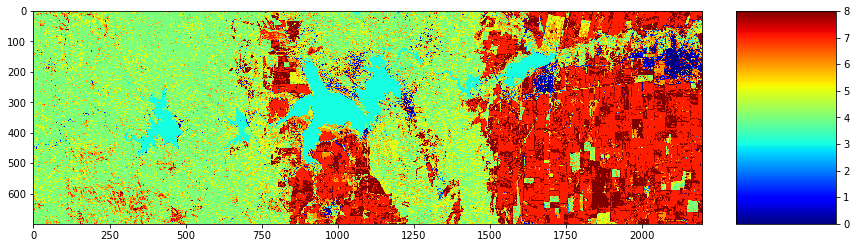

In [129]:
# plt.title("Originales Test")
fig = plt.figure(figsize=(12, 8))
grid = axes_grid1.AxesGrid(
    fig, 111, nrows_ncols=(1, 1), axes_pad = 0.5, cbar_location = "right",
    cbar_mode="each", cbar_size="15%", cbar_pad="5%",)

im1 = grid[0].imshow(pred_plot2, cmap='jet', interpolation='nearest')
grid.cbar_axes[0].colorbar(im1)

* In light blue we can see the water.
* In yellow the grasslands.
* In green the forest.
* In red crops.
* In blue the urban.

##### Importance of the variables in the predictive model.

Text(0.5, 1.0, 'Xgboost Feature Importance')

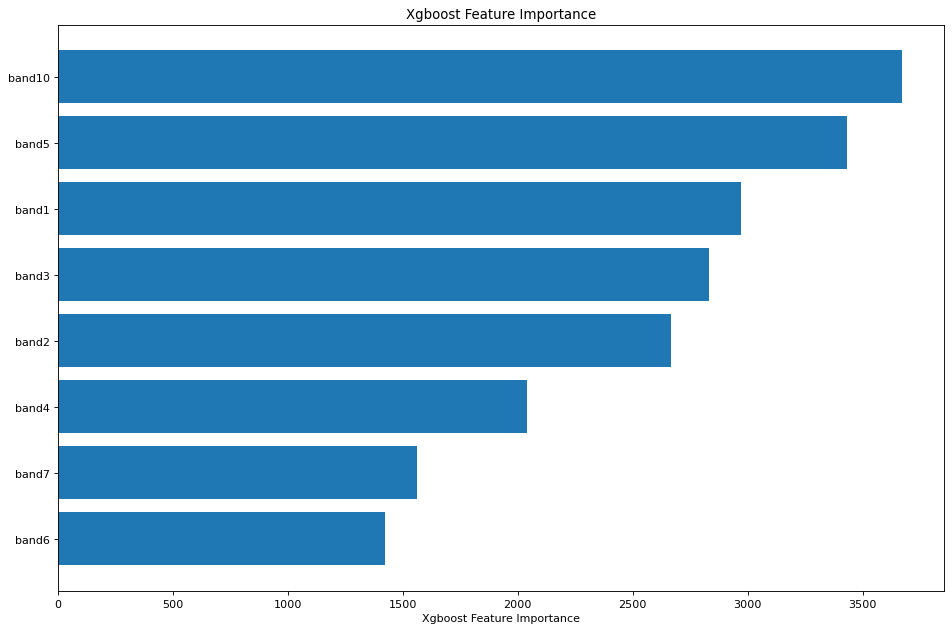

In [130]:
feature_important = model.get_booster().get_score(importance_type='weight')
keys = list(feature_important.keys())
values = list(feature_important.values())

data = pd.DataFrame(data=values, index=keys, columns=["score"]).sort_values(by = "score", ascending=False)
sorted_idx = data.score.argsort()
plt.figure(figsize=(12,8), dpi=80)
plt.barh(list(data.index), data.score[sorted_idx])
plt.xlabel("Xgboost Feature Importance")
plt.title("Xgboost Feature Importance")

We can see that the band that best differentiates land uses is band 10, followed by band 5, 1, 3 and so on. 